# Exploratory Data Analysis
This notebook performs EDA on `2000-2021_nofires+weather.csv` and `2000-2021_fires+weather.csv`, which has now been preprocessed and cleaned largely by now

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

In [36]:
df_no = pd.read_csv('2000-2021_nofires+weather.csv') # No wildfire
df_no['hectares'] = 0
df_yes = pd.read_csv('2000-2021_fires+weather.csv') # Wildfire dataset
df = pd.concat([df_yes, df_no])

In [37]:
df.describe()

,lat,lon,hectares,elevation,temp_c,max_temp_c,min_temp_c,wind_kph,wind_dir,precip_mm,humidity,pressure_hPa,soil_temp_c,soil_moisture,totalsnow_cm
count,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000,173558.000000
mean,52.763733,-112.071516,129.177976,754.117874,10.660298,16.681407,5.341760,13.848064,199.069128,1.282118,63.524727,928.229820,10.039554,0.334743,0.159646
std,3.491016,14.525921,3650.526019,460.432677,9.055219,9.518812,8.553774,5.825417,90.185755,3.205991,13.538265,50.371736,7.792177,0.126900,0.884895
min,42.915700,-136.375000,0.000000,-2.000000,-35.852000,-32.010000,-40.742000,1.800000,0.000000,0.000000,16.860000,717.632000,-19.478000,0.000000,0.000000
25%,50.153350,-120.154550,0.000000,404.000000,5.077000,10.735000,0.149000,9.660000,134.372250,0.000000,53.613000,893.092250,2.561250,0.244250,0.000000
50%,52.605000,-116.308767,0.000000,664.000000,12.233000,18.374000,6.704000,12.965000,213.690000,0.000000,63.341000,935.463500,11.236000,0.327000,0.000000
75%,55.446500,-110.771865,0.100000,1067.000000,17.572000,23.857750,11.779000,17.057000,266.595500,1.000000,73.428000,965.850750,16.607000,0.396000,0.000000
max,60.182700,-59.829412,577646.800000,2799.000000,36.833000,46.762000,27.171000,61.924000,360.000000,78.300000,99.987000,1040.466000,38.190000,0.764000,30.100000


In [38]:
df

,lat,lon,date,hectares,elevation,temp_c,max_temp_c,min_temp_c,wind_kph,wind_dir,precip_mm,humidity,pressure_hPa,soil_temp_c,soil_moisture,totalsnow_cm
0,56.713600,-110.449000,2000-01-01,0.20,347.0,-29.992,-25.265,-33.665,9.470,242.195,0.0,72.753,971.810,-1.340,0.585,0.0
1,54.752200,-114.914700,2000-01-03,0.30,827.0,-18.440,-13.971,-22.872,9.720,179.298,0.0,58.110,921.216,-8.824,0.558,0.0
2,53.661500,-102.177100,2000-01-06,0.30,264.0,-21.514,-18.139,-22.889,10.163,265.019,0.0,77.443,985.953,-1.606,0.587,0.0
3,51.072200,-115.300200,2000-01-07,0.50,1333.0,-8.396,-3.916,-10.766,17.917,249.972,0.0,81.143,853.531,0.592,0.212,0.0
4,51.066800,-115.128800,2000-01-07,0.25,1283.0,-6.168,-1.646,-8.895,17.917,249.972,0.0,72.987,860.034,-3.393,0.290,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
86774,49.881450,-114.011833,2021-10-20,0.00,1644.0,1.891,10.156,-2.694,12.387,171.290,0.0,79.652,831.251,-0.375,0.226,0.0
86775,54.039500,-109.323767,2021-10-21,0.00,551.0,0.967,4.910,-2.790,15.630,101.629,0.0,69.323,954.092,1.842,0.216,0.0
86776,49.513200,-124.850600,2021-10-22,0.00,35.0,11.089,13.108,9.558,25.772,147.717,10.2,91.173,1000.783,11.118,0.317,0.0
86777,49.513800,-124.849900,2021-10-24,0.00,30.0,9.678,10.490,8.790,35.946,132.132,15.7,93.895,986.835,9.770,0.322,0.0


In [39]:
df['class'] = df['hectares'].apply(lambda x: 1 if x > 0 else 0)

In [40]:
no_fire_count = df[df['class'] == 0].shape[0]
fire_count = df[df['class'] == 1].shape[0]
print(f"No Fire Count: {no_fire_count}, Percentage: {no_fire_count / len(df) * 100:.2f}%")
print(f"Fire Count: {fire_count}, Percentage: {fire_count / len(df) * 100:.2f}%")

No Fire Count: 87333, Percentage: 50.32%
Fire Count: 86225, Percentage: 49.68%


This makes sense because some wildfires in the wildfire dataset have 0 hectares

In [7]:
# Create year, month, day columns
df['date'] = pd.to_datetime(df['date'])
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['day'] = df['date'].dt.day

## Distributions across time

In [9]:
px.histogram(df, x='year', title='Yearly distribution', color='class', color_discrete_map={1: 'red', 0: 'blue'})

Yearly distributions seems normal, there seems to be around the same amount of wildfires roughly every year (even distribution)

In [10]:
px.histogram(df, x='month', title='Monthly distribution', color='class', color_discrete_map={1: 'red', 0: 'blue'})

 Monthly distributions are as expected. There are more wildfires during the hotter months (towards june-july-august). We could use the month as an additional column for the 

In [11]:
px.histogram(df, x='day', title='Daily distribution', color='class', color_discrete_map={1: 'red', 0: 'blue'})

Daily distributions are spread out evenly, which is normal since there is no reason why there would be more wildfires on a specific day

## Weather data analysis

In [18]:
px.scatter(df.sample(5000),
           title='Max Temp vs Min Temp',
           x='min_temp_c', 
           y='max_temp_c',
           opacity=0.5,
           color='class')

In [19]:
px.histogram(df, x='temp_c', title='Mean temperature vs number of wildfires', color='class', color_discrete_map={1: 'red', 0: 'blue'})

Higher temperatures (min and max) indicate higher likelihood of wildfire

In [20]:
px.scatter(df.sample(5000),
           title='Humidity vs Mean Temp',
           x='humidity', 
           y='temp_c',
           opacity=0.5,
           color='class')

In [21]:
px.scatter(df.sample(5000),
           title='Hectares vs precipitation',
           x='precip_mm', 
           y='hectares',
           opacity=0.5,
           color='class')

In [22]:
px.scatter(df.sample(5000),
           title='Hectares vs. total snow',
           x='totalsnow_cm', 
           y='hectares',
           opacity=0.5,
           color='class')

In [27]:
px.scatter(df.sample(5000),
           title='Hectares vs elevation',
           x='elevation', 
           y='hectares',
           opacity=0.5,
           color='class')

In [28]:
px.scatter(df.sample(5000),
           title='Hectares vs wind',
           x='wind_kph', 
           y='hectares',
           opacity=0.5,
           color='class')

In [29]:
px.scatter(df,
           title='Hectares vs pressure',
           x='pressure_hPa', 
           y='hectares',
           opacity=0.5,
           color='class')

In [30]:
px.scatter(df,
           title='Hectares vs soil temperature',
           x='soil_temp_c', 
           y='hectares',
           opacity=0.5,
           color='class')

In [31]:
px.scatter(df,
           title='Hectares vs soil temperature',
           x='soil_moisture', 
           y='hectares',
           opacity=0.5,
           color='class')

In [33]:
cat_columns = df.select_dtypes(include='object').columns.tolist()
num_columns = df.select_dtypes(exclude='object').columns.tolist()
print('Categorical features:',cat_columns)
print('Numerical features:',num_columns)

Categorical features: []
Numerical features: ['lat', 'lon', 'date', 'hectares', 'elevation', 'temp_c', 'max_temp_c', 'min_temp_c', 'wind_kph', 'wind_dir', 'precip_mm', 'humidity', 'pressure_hPa', 'soil_temp_c', 'soil_moisture', 'totalsnow_cm', 'class', 'year', 'month', 'day']


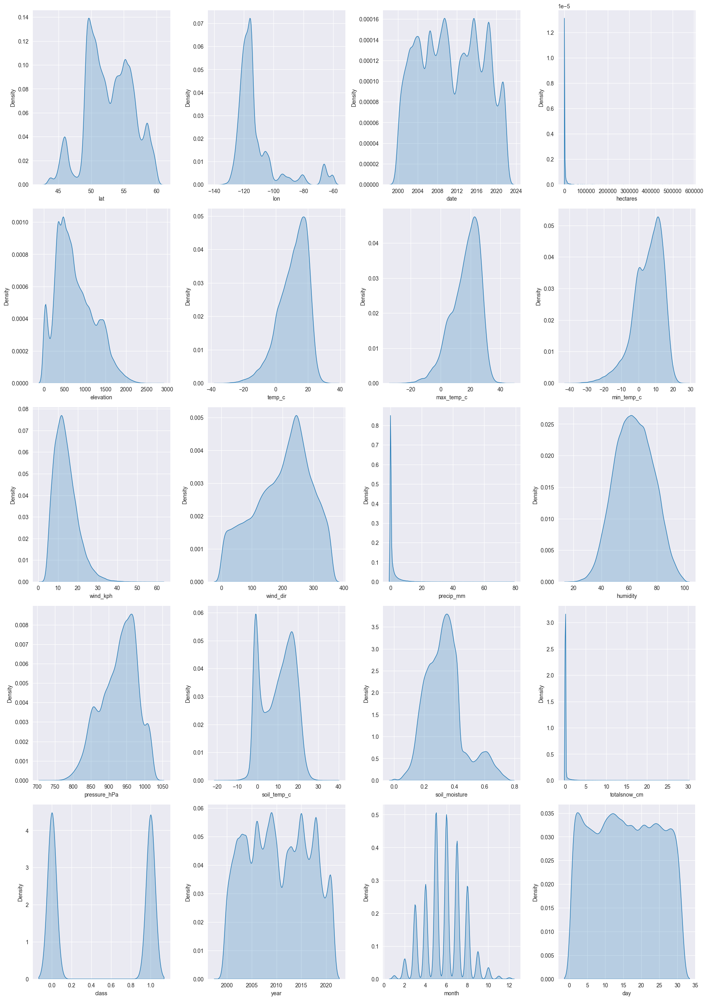

In [34]:
# Plotting KDE (Kernel Density Estimate) for all numerical columns
plt.figure(figsize=(18,40))
for i,col in enumerate(num_columns,1):
    plt.subplot(8,4,i)
    sns.kdeplot(df[col],fill=True)
plt.tight_layout() 
plt.show()

In [24]:
corr_matrix = df[num_columns].corr()

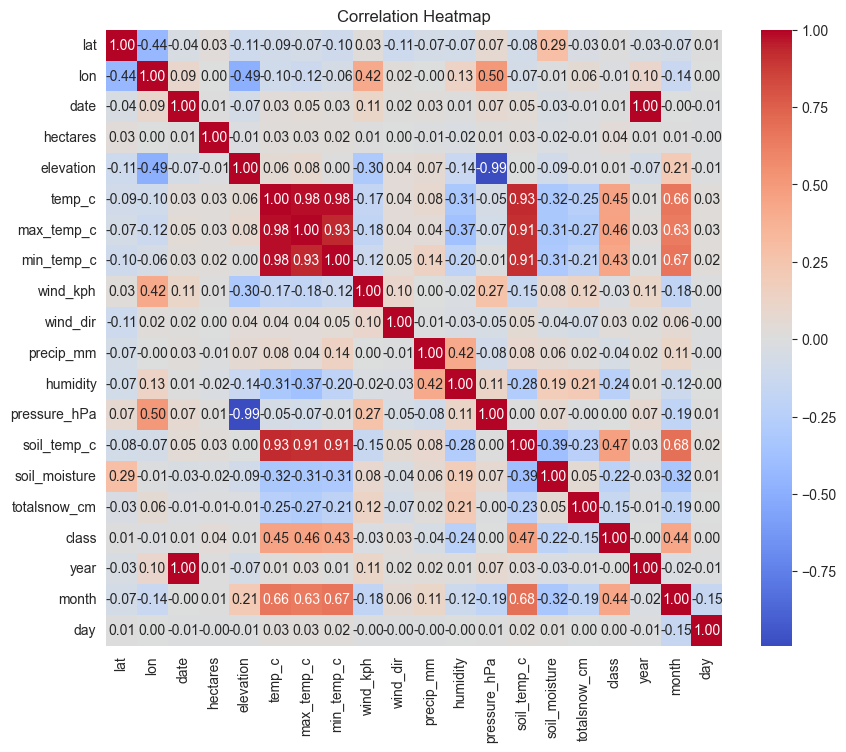

In [25]:
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Correlation Heatmap')
plt.show()